In [19]:
import numpy as np
import agentpy as ap 
import matplotlib.pyplot as plt
import IPython
import random
import pytransform3d.plot_utils as p3d
from pytransform3d.transformations import translate_transform

%matplotlib notebook

random.seed(12345)

In [3]:
def normalize(v):
    norm = np.linalg.norm(v)
    if norm == 0:
        return v
    return v / norm

In [4]:
class AircraftAgent(ap.Agent):
    def setup(self):
        self.max_vel = 20
        self.path = []
        
    def setup_fail(self, fail_prob):
        self.fail_prob = fail_prob
        self.failed = False
    
    def setup_pos(self, space:ap.Space):
        self.space = space
        self.neighbors = space.neighbors
        self.position = space.positions[self]
        
    def setup_goal(self, space: ap.Space, goal=np.array([0,0,0])):
        self.goal = goal
        self.path.append(goal)
        self.path_idx = 0
    
    def update(self):
        if random.random() < self.fail_prob and not self.failed:
            self.failed = True
            self.position[2] = 100
            for p in self.path:
                p[2] = 100
            self.space.move_to(self, self.position)
            return
        sub_goal = self.path[self.path_idx]
        vec_to_goal = sub_goal - self.position
        step_to_goal = normalize(vec_to_goal) * self.max_vel
        new_pos = self.position + step_to_goal
        self.position = new_pos
        self.space.move_to(self, new_pos)

In [5]:
class LimaModel(ap.Model):
    def setup(self):
        self.space = ap.Space(self, shape=[self.p.size]*self.p.ndim)
        self.agents = ap.AgentList(self, self.p.population, AircraftAgent)
        lanes = [self.get_random_lane() for agent in self.agents]
        self.space.add_agents(self.agents, positions=[lane[0].copy() for lane in lanes])
        self.agents.setup_pos(self.space)
        self.agents.setup_fail(self.p.fail_prob)
        for agent, goal in zip(self.agents, [lane[1] for lane in lanes]):
            agent.setup_goal(self.space, goal.copy())
    
    def step(self):
        self.agents.update()
        if self.t % self.p.spawn_rate == 0:
            new_agent = AircraftAgent(self)
            lane = self.get_random_lane()
            self.agents.append(new_agent)
            self.space.add_agents([new_agent],[lane[0].copy()])
            new_agent.setup_pos(self.space)
            new_agent.setup_goal(self.space, lane[1].copy())
            new_agent.setup_fail(self.p.fail_prob)
            
    def get_random_lane(self):
        return random.choice(self.p.lanes)
        

In [32]:
def animation_plot_single(m, ax):
    ndim = m.p.ndim
    pos = m.agents.position
    pos = np.array(list(pos)).T  # Transform
    ax.scatter(*pos, s=1, c='black')
    ax.set_xlim(0, m.p.size)
    ax.set_ylim(0, m.p.size)
    if ndim == 3:
        ax.set_zlim(0, m.p.size)
    for lane in m.p.lanes:
        ax.scatter(*lane[0], c='r')
        ax.scatter(*lane[1], c='b')
        half_height_start = lane[0][2]/2
        start_atz_centre = np.array([lane[0][0], lane[0][1], half_height_start])
        half_height_end = lane[1][2]/2
        end_atz_centre = np.array([lane[1][0], lane[1][1], half_height_end])
        p3d.plot_cylinder(ax=ax, wireframe=False, alpha=0.2, radius=20, length=lane[0][2], A2B=translate_transform(np.eye(4), start_atz_centre))
        p3d.plot_cylinder(ax=ax, wireframe=False, alpha=0.2, radius=20, length=lane[1][2], A2B=translate_transform(np.eye(4), end_atz_centre))

#     ax.set_axis_off()

def animation_plot(m, p):
    projection = '3d' if p['ndim'] == 3 else None
    fig = plt.figure(figsize=(9,9))
    ax = fig.add_subplot(111, projection=projection)
    animation = ap.animate(m(p), fig, ax, animation_plot_single)
    return IPython.display.HTML(animation.to_jshtml(fps=20))

<IPython.core.display.Javascript object>


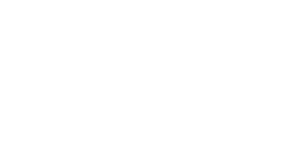

Animation size has reached 21093395 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [34]:
params = {
    'ndim': 3,
    'size': 2000,
    'population': 10,
    'steps': 500,
    'spawn_rate': 5, #steps per spawn
    'fail_prob': 0.005, # Failure probability of each agent at each timestep
    'lanes': [[[20,50,200], [1800,50,200]], [[1800,1500,200], [20,1500,200]]]
}
animation_plot(LimaModel, params)